In [17]:
# import pytorch ver 1.4.0 and pycocotools

%matplotlib inline
import torch
import torchvision
!pip install pycocotools
import pycocotools.cocoeval
if torch.__version__ != "1.4.0":
    print("This code uses pytorch 1.4.0!")
    assert False

DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

You are using pip version 9.0.1, however version 21.3.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [18]:
# download training and test data
import os
if not os.path.exists('./rebar_count_datasets'):
    print('Downloading code and datasets...')
    os.system("wget -N https://cnnorth4-modelhub-datasets-obsfs-sfnua.obs.cn-north-4.myhuaweicloud.com/content/c2c1853f-d6a6-4c9d-ac0e-203d4c304c88/NkxX5K/dataset/rebar_count_datasets.zip")
    os.system("unzip -q rebar_count_datasets.zip; rm rebar_count_datasets.zip")
    if os.path.exists('./rebar_count_datasets'):
         print('Download code and datasets success')
    else:
         print('Download code and datasets failed, please check the download url is valid or not.')
else:
    print('./rebar_count_datasets already exists')

./rebar_count_datasets already exists


In [19]:
# downloading pytorch vision coco helper
!wget -N https://github.com/pytorch/vision/archive/refs/tags/v0.6.0.zip
!unzip -o v0.6.0.zip; rm v0.6.0.zip

!cp ./vision-0.6.0/references/detection/utils.py ./
!cp ./vision-0.6.0/references/detection/transforms.py ./
!cp ./vision-0.6.0/references/detection/coco_eval.py ./
!cp ./vision-0.6.0/references/detection/engine.py ./
!cp ./vision-0.6.0/references/detection/coco_utils.py ./

import utils
import transforms as T

def get_transform(train):
    transforms = []
    transforms.append(T.ToTensor())
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

--2021-10-29 18:51:25--  https://github.com/pytorch/vision/archive/refs/tags/v0.6.0.zip
Resolving proxy-notebook.modelarts.com (proxy-notebook.modelarts.com)... 192.168.2.126
Connecting to proxy-notebook.modelarts.com (proxy-notebook.modelarts.com)|192.168.2.126|:8083... connected.
Proxy request sent, awaiting response... 302 Found
Location: https://codeload.github.com/pytorch/vision/zip/refs/tags/v0.6.0 [following]
--2021-10-29 18:51:26--  https://codeload.github.com/pytorch/vision/zip/refs/tags/v0.6.0
Connecting to proxy-notebook.modelarts.com (proxy-notebook.modelarts.com)|192.168.2.126|:8083... connected.
Proxy request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘v0.6.0.zip’

v0.6.0.zip              [   <=>              ]   5.85M  9.95MB/s    in 0.6s    

Last-modified header missing -- time-stamps turned off.
2021-10-29 18:51:27 (9.95 MB/s) - ‘v0.6.0.zip’ saved [6132838]

Archive:  v0.6.0.zip
b68adcf9a9280aef02fc08daed170d74d0892361
 extracti

/home/ma-user/anaconda3/envs/Pytorch-1.4.0/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


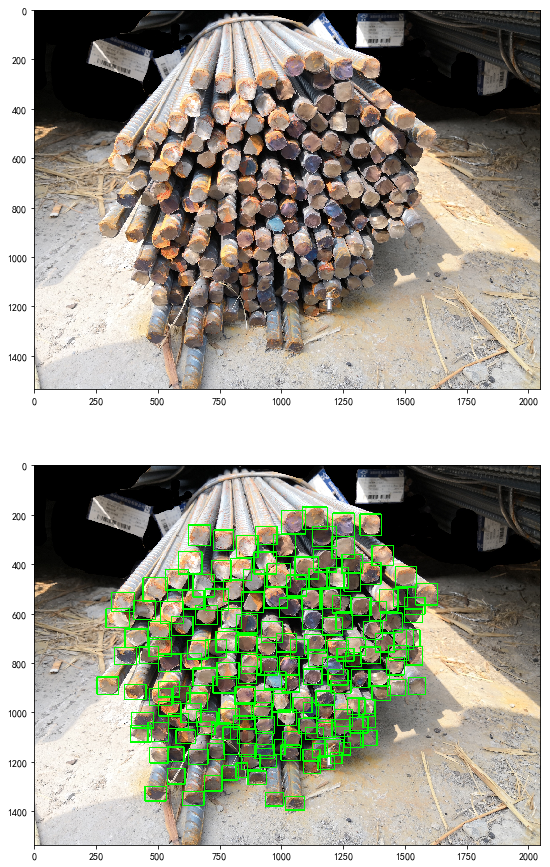

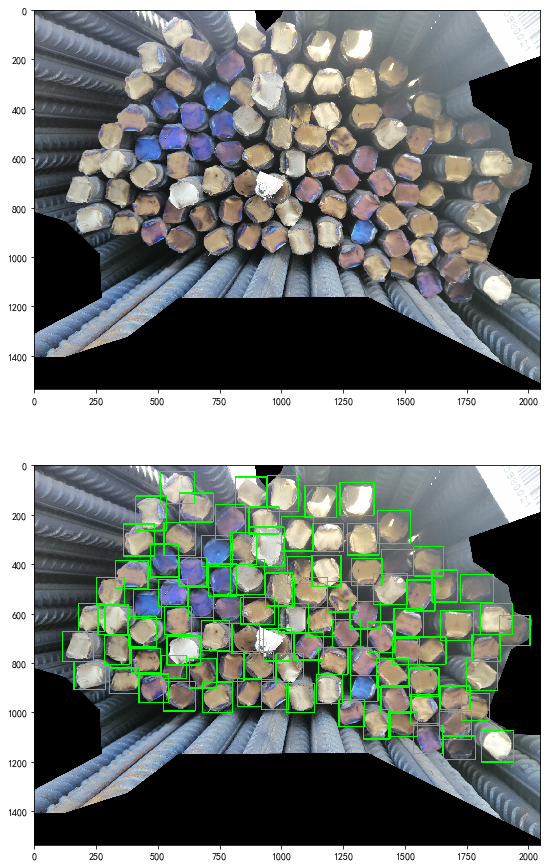

In [20]:
# inspecting data
import xml.etree.ElementTree as ET
import numpy as np
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import cv2

def read_xml(xml_path):
    tree = ET.parse(xml_path)
    root = tree.getroot()
    boxes = []
    labels = []
    for element in root.findall('object'):
        label = element.find('name').text
        if label == 'steel':
            bndbox = element.find('bndbox')
            xmin = bndbox.find('xmin').text
            ymin = bndbox.find('ymin').text
            xmax = bndbox.find('xmax').text
            ymax = bndbox.find('ymax').text
            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(label)
    return np.array(boxes, dtype=np.float64), labels

train_img_dir = './rebar_count_datasets/VOC2007/JPEGImages'
train_xml_dir = './rebar_count_datasets/VOC2007/Annotations'
files = os.listdir(train_img_dir)
files.sort()
for index, file_name in enumerate(files[:2]):
    img_path = os.path.join(train_img_dir, file_name)
    xml_path = os.path.join(train_xml_dir, file_name.split('.jpg')[0]+'.xml')
    boxes, labels = read_xml(xml_path)
    img = Image.open(img_path)
    resize_scale = 2048.0 / max(img.size)
    img = img.resize((int(img.size[0] * resize_scale), int(img.size[1] * resize_scale)))
    boxes *= resize_scale
    plt.figure(figsize=(img.size[0]/100.0, img.size[1]/100.0))
    plt.subplot(2,1,1)
    plt.imshow(img)
    img = img.convert('RGB')
    img = np.array(img)
    img = img.copy()
    for box in boxes:
        xmin, ymin, xmax, ymax = box.astype(np.int)
        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), thickness=3)
        plt.subplot(2,1,2)
        plt.imshow(img)
        
plt.show()

In [21]:
# creating pytorch dataset for rebar
class RebarDataset(torch.utils.data.Dataset):
    def __init__(self, root, transforms=None):
        self.root = root
        self.transforms = transforms
        self.imgs = list(sorted(os.listdir(os.path.join(root, "JPEGImages"))))
        
        if ".ipynb_checkpoints" in self.imgs:
            self.imgs.remove(".ipynb_checkpoints")
        


    def __getitem__(self, idx):
        img_path = os.path.join(self.root, "JPEGImages", self.imgs[idx])
        box_path = os.path.join(self.root, "Annotations", self.imgs[idx].split(".")[0]+'.xml')
        img = Image.open(img_path).convert("RGB")
        boxes,_ = read_xml(box_path) # xml something"

        boxes = torch.as_tensor(boxes, dtype=torch.float32 , device = DEVICE)
        labels = torch.ones((len(boxes),), dtype=torch.int64 , device = DEVICE)
        
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        iscrowd = torch.zeros((len(boxes),), dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = torch.tensor([idx], device = DEVICE)
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.imgs)

In [22]:
# load faster rcnn model pretrained with resnet50 backbone
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

num_classes = 2  # 1 rebar + background
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(
    pretrained=True,
    progress=True,
)

in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes) 
model.roi_heads.detections_per_img=500 # max object detection
pycocotools.cocoeval.Params.setDetParams.maxDets = [5, 50, 500]
model.to(DEVICE)


FasterRCNN(
  (transform): GeneralizedRCNNTransform()
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d()
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d()
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d()
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d()
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d()
          )
  

In [23]:
# load datasets and apply transforms
train_dataset = RebarDataset("./rebar_count_datasets/VOC2007/",get_transform(True))
test_dataset = RebarDataset("./rebar_count_datasets/VOC2007/",get_transform(False))

# torch.manual_seed(1)
indices = torch.randperm(len(train_dataset)).tolist()
# 70 - 30 split
train_dataset = torch.utils.data.Subset(train_dataset, indices[:-50]) #200
test_dataset = torch.utils.data.Subset(test_dataset, indices[-50:]) #50

# create data loaders
train_data_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=2, shuffle=True,
    collate_fn=utils.collate_fn)

test_data_loader = torch.utils.data.DataLoader(
    test_dataset, batch_size=1, shuffle=False,
    collate_fn=utils.collate_fn)


In [24]:
# create optimizer and learning rate scheduler
from torch.optim.lr_scheduler import StepLR

model.to(DEVICE)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=3e-4)
#torch.optim.SGD(params, lr=0.005,
#                            momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=1,
                                               gamma=0.06)

In [25]:
# train the model and save every epoch
from engine import train_one_epoch,evaluate

num_epochs = 4

for epoch in range(num_epochs):
    model.to(DEVICE)
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, train_data_loader, DEVICE, epoch, print_freq=10)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, test_data_loader, device=DEVICE)
    
    path = os.path.join("./model", f'model_{epoch}.pth')
    torch.save(model.cpu().state_dict(), path) # saving model
    model.to(DEVICE)
     # moving model to GPU for further training

Epoch: [0]  [  0/100]  eta: 0:01:04  lr: 0.000003  loss: 3.0201 (3.0201)  loss_classifier: 0.7212 (0.7212)  loss_box_reg: 0.2619 (0.2619)  loss_objectness: 1.8325 (1.8325)  loss_rpn_box_reg: 0.2045 (0.2045)  time: 0.6468  data: 0.3960  max mem: 4458
Epoch: [0]  [ 10/100]  eta: 0:00:53  lr: 0.000034  loss: 1.1281 (1.6046)  loss_classifier: 0.5870 (0.5739)  loss_box_reg: 0.2769 (0.2779)  loss_objectness: 0.2057 (0.6206)  loss_rpn_box_reg: 0.1278 (0.1322)  time: 0.5961  data: 0.3677  max mem: 4592
Epoch: [0]  [ 20/100]  eta: 0:00:46  lr: 0.000064  loss: 0.8710 (1.1800)  loss_classifier: 0.3396 (0.4135)  loss_box_reg: 0.2404 (0.2533)  loss_objectness: 0.1380 (0.3811)  loss_rpn_box_reg: 0.1260 (0.1321)  time: 0.5744  data: 0.3466  max mem: 4592


KeyboardInterrupt: 

This code uses pytorch 1.4.0!


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to C:\Users\nicho/.cache\torch\hub\checkpoints\fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100.0%


Loading model from ./model\model_3.pth


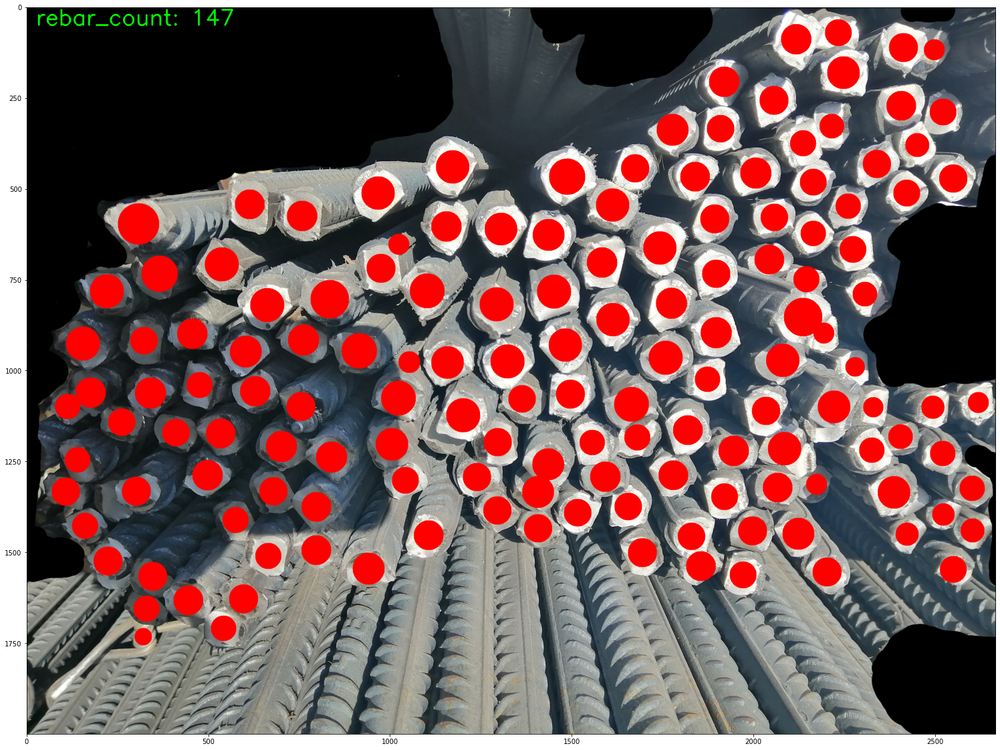

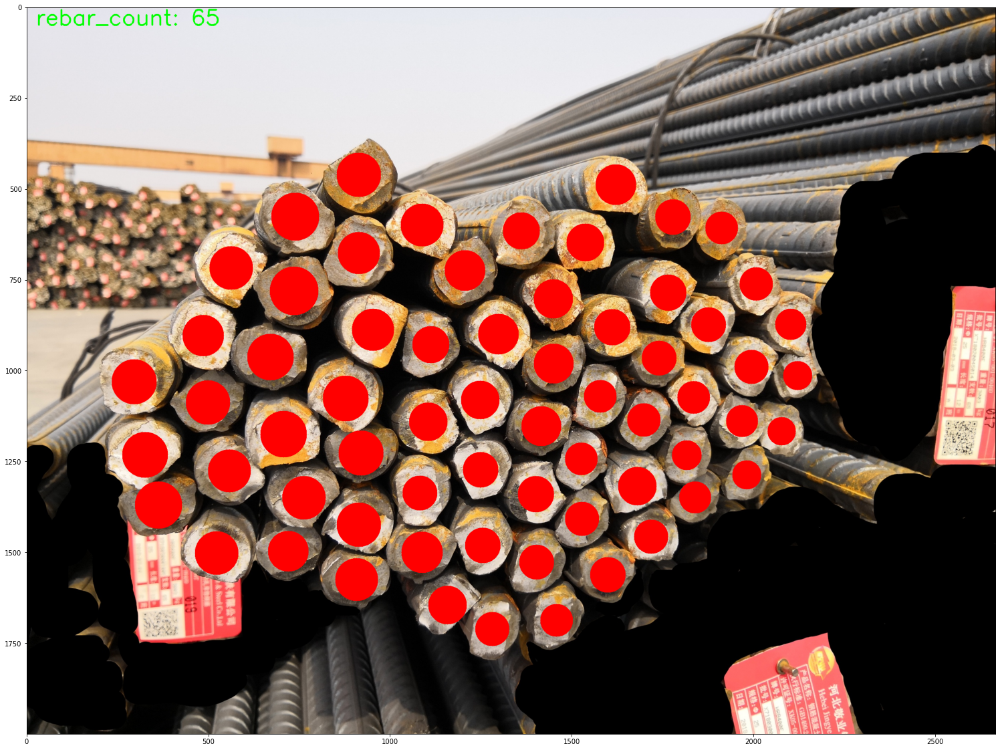

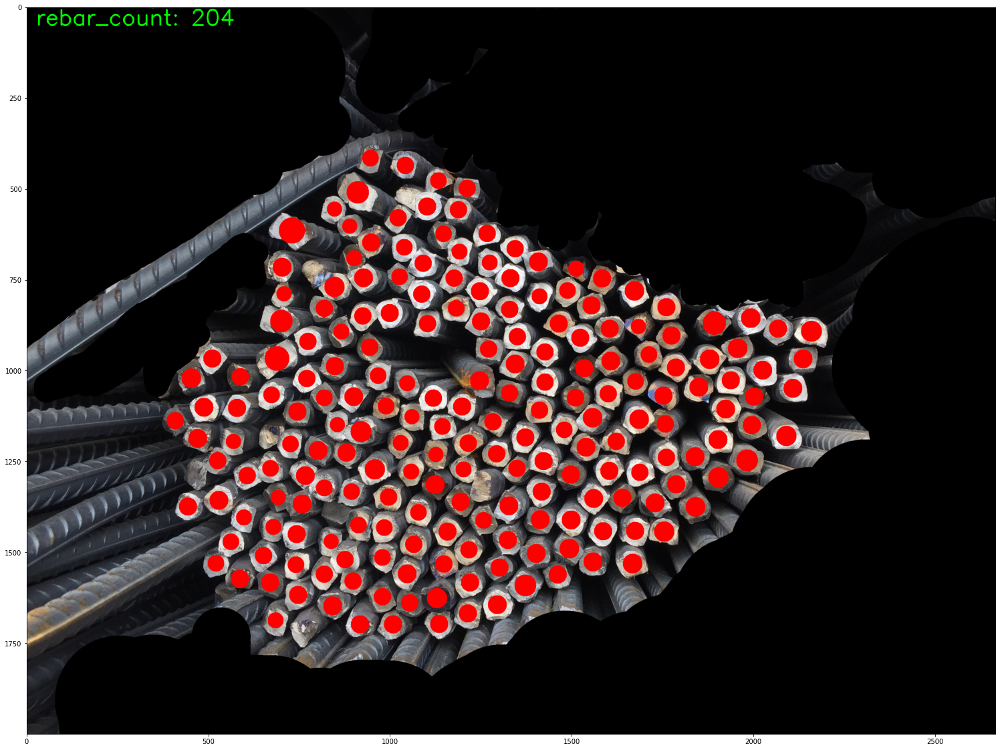

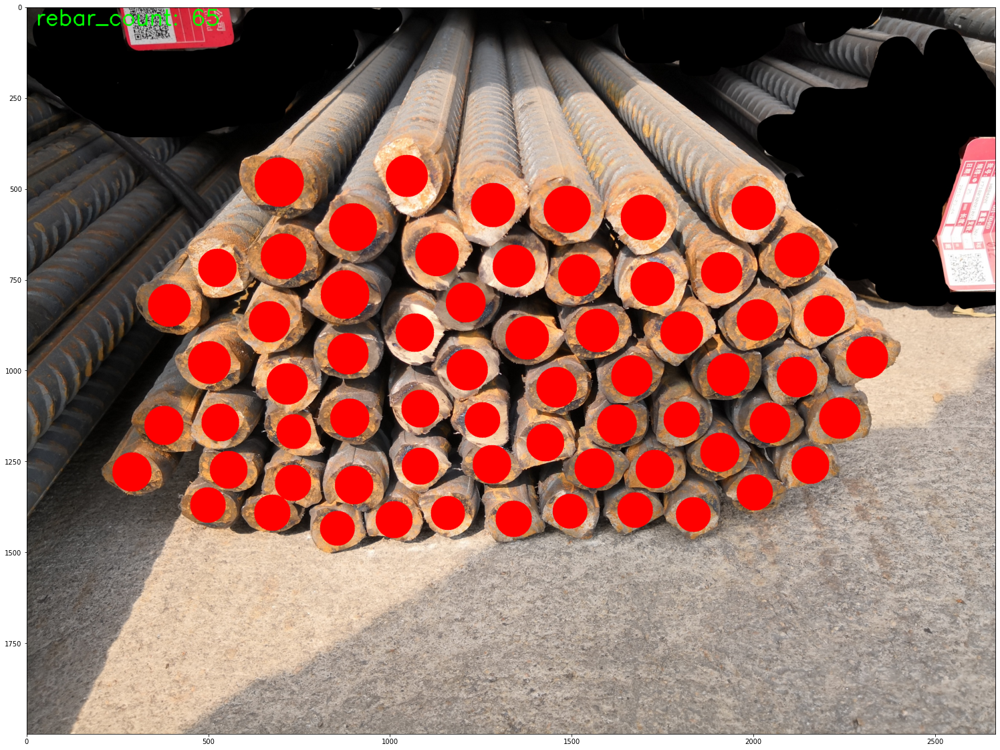

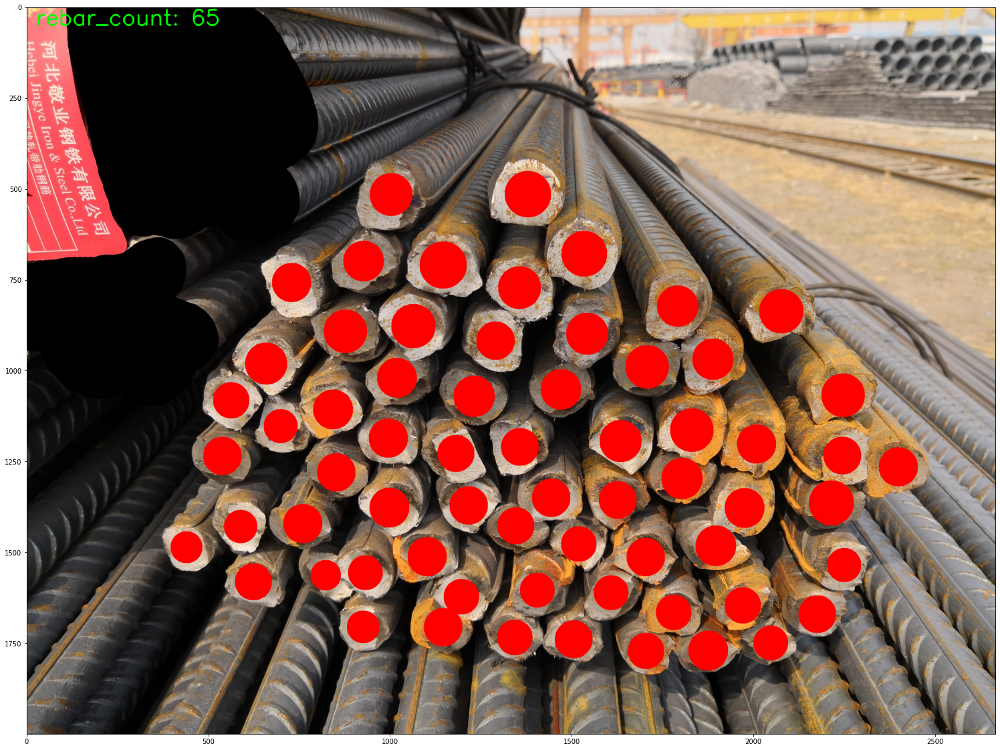

...

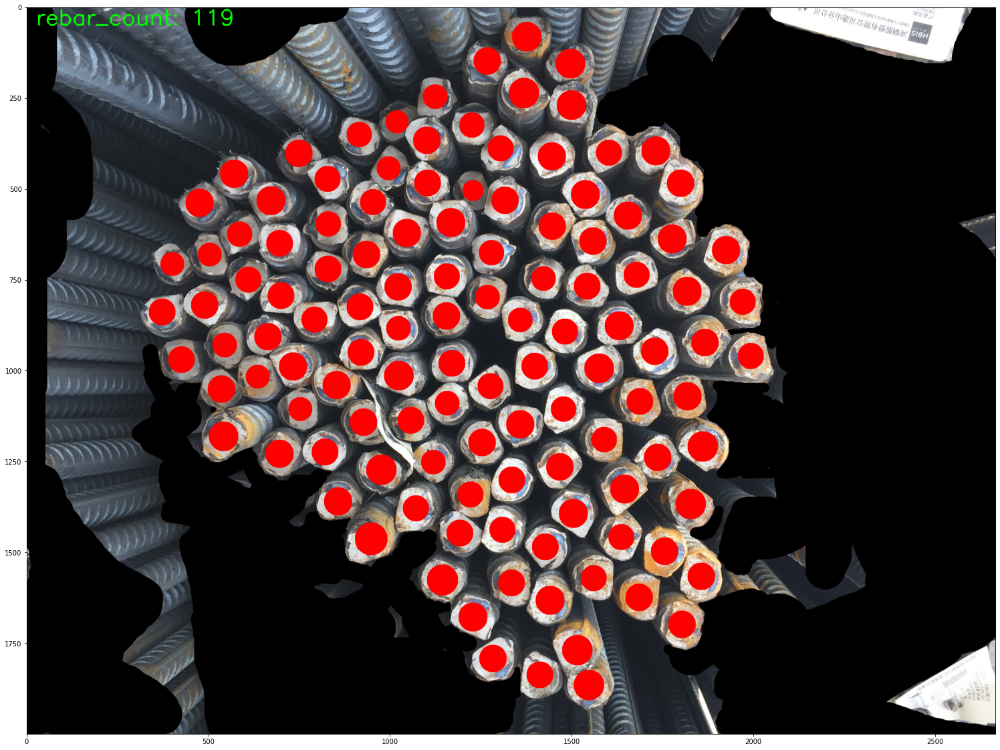

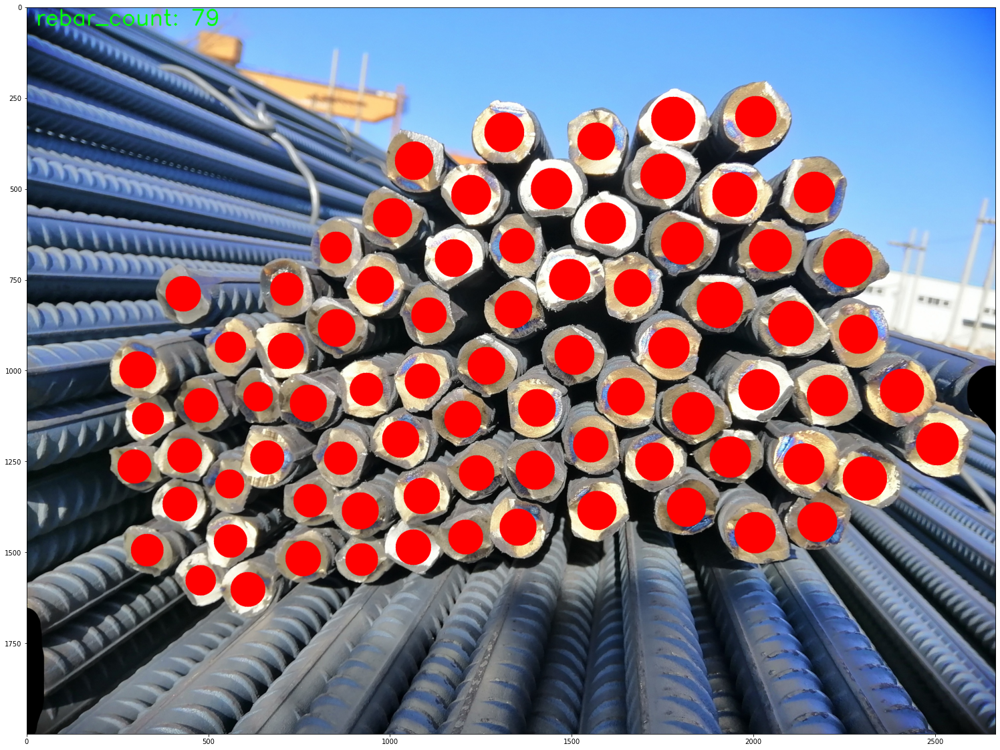

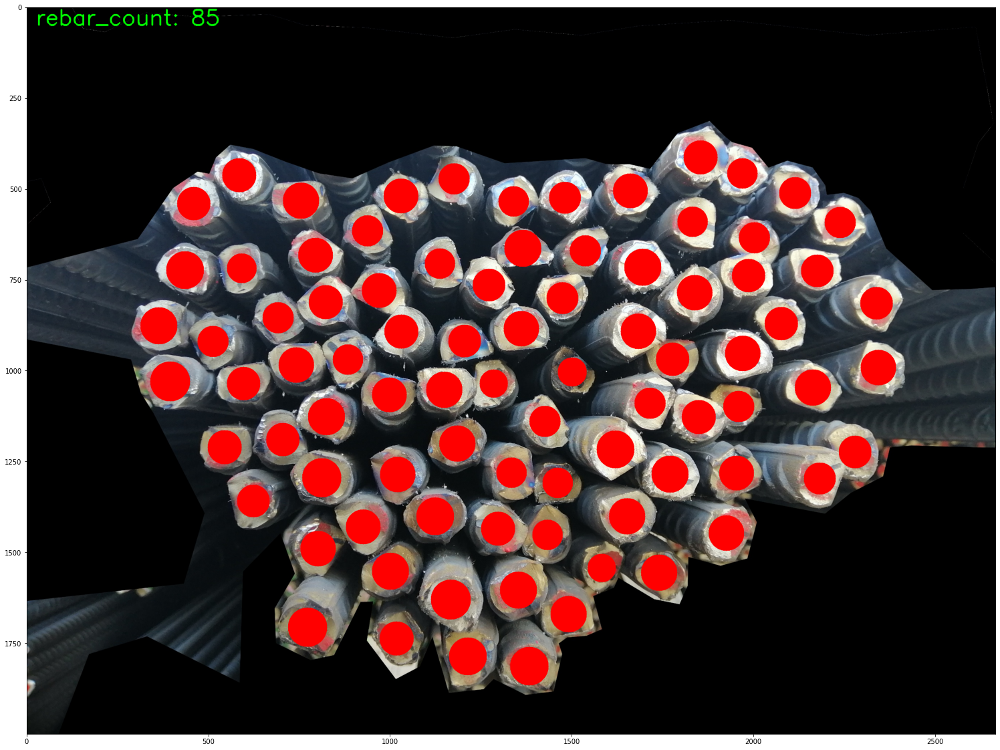

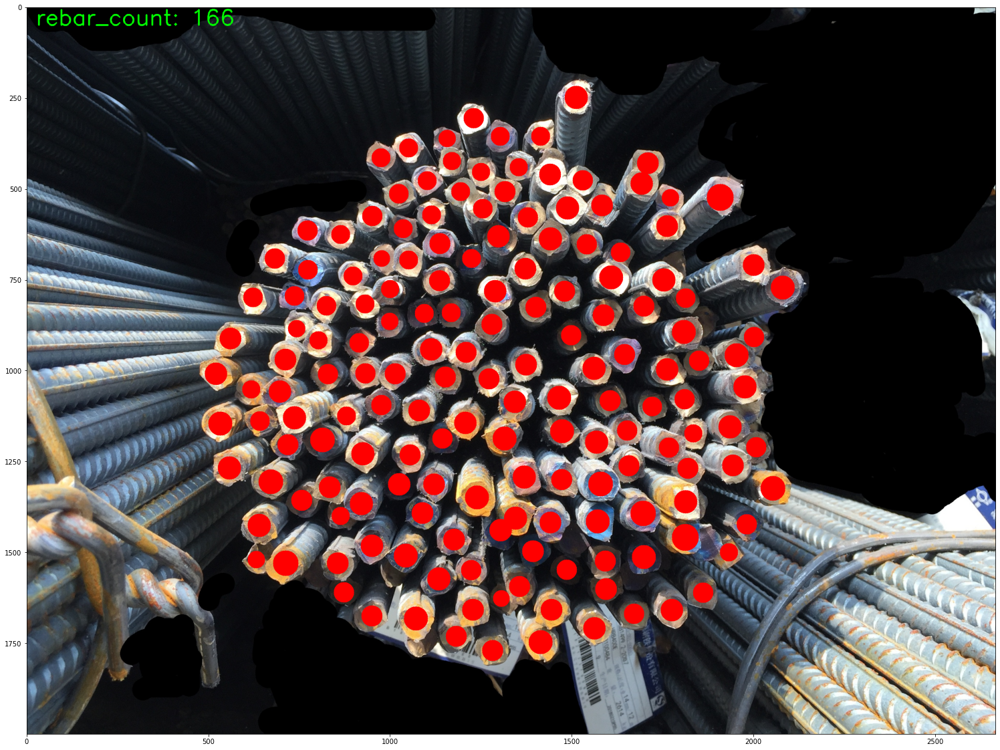

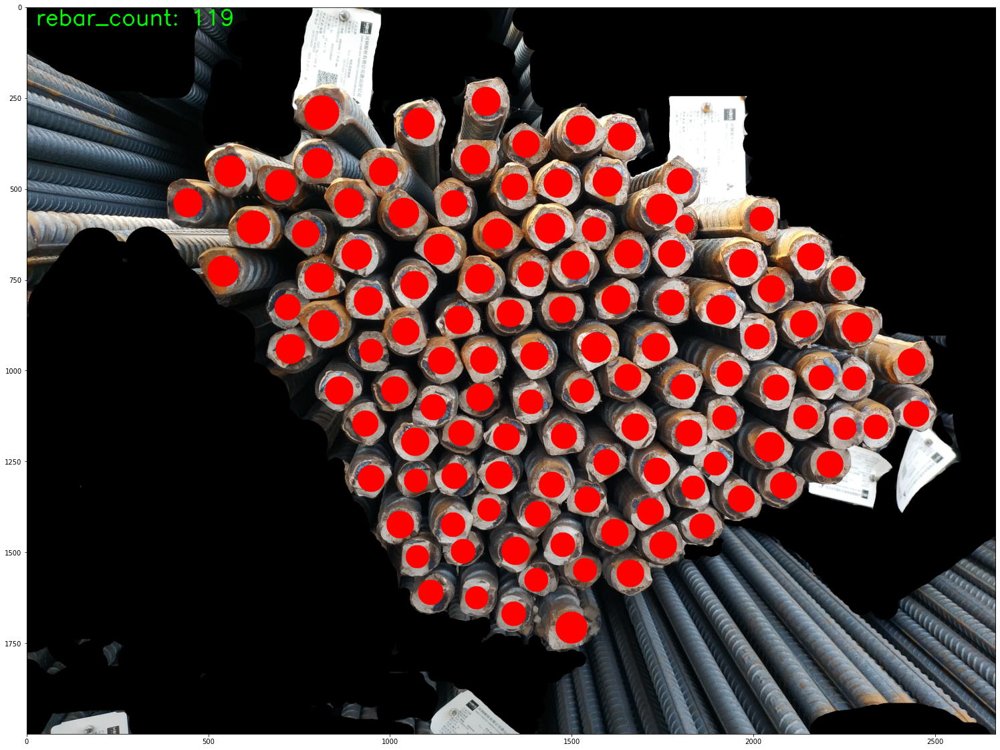

In [1]:
# load last epoch
import torch
if torch.__version__ != "1.4.0":
    print("This code uses pytorch 1.4.0!")
    # assert False
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
# import pycocotools.cocoeval
import os
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt
import cv2

DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

num_classes = 2  # 1 rebar + background
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(
    pretrained=True,
    progress=True,
)

in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes) 
model.roi_heads.detections_per_img=500 # max object detection
# pycocotools.cocoeval.Params.setDetParams.maxDets = [5, 50, 500]
model.to(DEVICE)

trained_models = os.listdir('./model')
latest_epoch = -1
for model_name in trained_models:
    if not model_name.endswith('pth'):
        continue
    epoch = float(model_name.split('_')[1].split('.pth')[0])
    if epoch > latest_epoch:
        latest_epoch = epoch
        best_model_name = model_name
        
best_model_path = os.path.join('./model', best_model_name)
print('Loading model from', best_model_path)
model.load_state_dict(torch.load(best_model_path))


# results
import numpy
import random
model.eval()
test_img_dir = r'./rebar_count_datasets/test_dataset'

files = os.listdir(test_img_dir)
random.shuffle( files)
if ".ipynb_checkpoints" in files:
    files.remove(".ipynb_checkpoints")
for i, file_name in enumerate(files[:15]):
    image_src = Image.open(os.path.join(test_img_dir, file_name)).convert("RGB")
    img_tensor = torchvision.transforms.ToTensor()(image_src)
    img_tensor
    with torch.no_grad():
        result_dict = model([img_tensor.to(DEVICE)])
    bbox = result_dict[0]["boxes"].cpu().numpy()
    scrs = result_dict[0]["scores"].cpu().numpy()

    image_draw = numpy.array(image_src.copy())
   
    rebar_count = 0
    for bbox,scr in zip(bbox,scrs):
        if len(bbox) > 0:
            if scr > 0.65:
                pt = bbox
                cv2.circle(image_draw, (int((pt[0] + pt[2]) * 0.5), int((pt[1] + pt[3]) * 0.5)), int((pt[2] - pt[0]) * 0.5 * 0.6), (255, 0, 0), -1)
                rebar_count += 1
    cv2.putText(image_draw, 'rebar_count: %d' % rebar_count, (25, 50), cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 0), 3)
    plt.figure(i, figsize=(30, 20))
    plt.imshow(image_draw)
    plt.show()